# 0. Prepare Path

In [1]:
base_path = './'

Install requirements

In [2]:
!pip install pythreejs
!pip install opencv-python
!pip install opencv-python-headless
!pip install ipympl
!pip install open3d
!pip install PyMaxflow

## Import packages

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import open3d as o3d
import os
import pythreejs as p3js
import pandas as pd
from IPython.display import display
from math import sqrt
import maxflow
from skimage import measure
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from mpl_toolkits.mplot3d import Axes3D
import sys

from skimage import io
from skimage.transform import resize
from skimage.transform import warp, ProjectiveTransform
from skimage.color import rgb2gray, rgba2rgb
import plotly.graph_objects as go

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# 1. Dense 3D Reconstruction

## Load stereo images

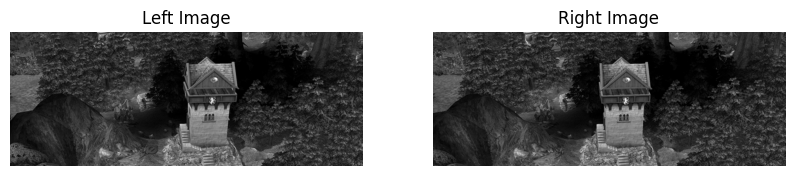

In [4]:
%matplotlib inline

# Load the left and right images
img_left_path = os.path.join(base_path, 'input_0.png')
img_right_path = os.path.join(base_path, 'input_1.png')

img_left = cv2.imread(img_left_path, cv2.IMREAD_GRAYSCALE)
img_right = cv2.imread(img_right_path, cv2.IMREAD_GRAYSCALE)

# 이미지가 잘 불러와졌는지 확인
if img_right is None or img_left is None:
    print("Error: Could not load images.")
else:
    # 이미지를 표시
    plt.figure(figsize=(10, 5))

    # Left 이미지 표시
    plt.subplot(1, 2, 1)
    plt.imshow(img_left, cmap='gray')
    plt.title('Left Image')
    plt.axis('off')

    # Right 이미지 표시
    plt.subplot(1, 2, 2)
    plt.imshow(img_right, cmap='gray')
    plt.title('Right Image')
    plt.axis('off')

    # 이미지를 화면에 표시
    plt.show()

## Compute the disparity map (10 minutes)

In [5]:
################################################################################
# CODE HERE
# Create a stereo block matching object
# function: cv2.StereoBM_create
# arguments: numDisparities(int) = 16, blockSize(int) = 5 ~ 21 anything you want
stero = cv2.StereoBM_create(16, 15)

# Compute the disparity map
# function: cv2.StereoBM.compute
# arguments: cv2 images
disparity = stero.compute(img_left, img_right)
################################################################################

## 	Normalize the disparity map for visualization (5 minutes)

In [6]:
################################################################################
# CODE HERE
# Normalize the values to a range from 0..255 for display purposes
# function: cv2.normalize
# arguments: disparity(numpy array), disparity(numpy array), alpha(int), beta(int), norm_type(int)
disparity = cv2.normalize(disparity, disparity, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
################################################################################

disparity = np.uint8(disparity)

## Display the disparity map

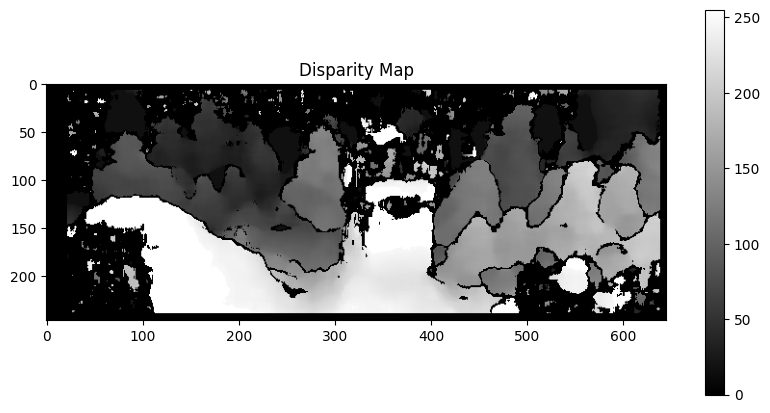

In [7]:
plt.figure(figsize=(10, 5))
plt.imshow(disparity, cmap='gray')
plt.colorbar()
plt.title('Disparity Map')
plt.show()

## Compute depth from the disparity map (5minutes)

$\text{Depth} = \frac{f \cdot B}{\text{Disparity}}$

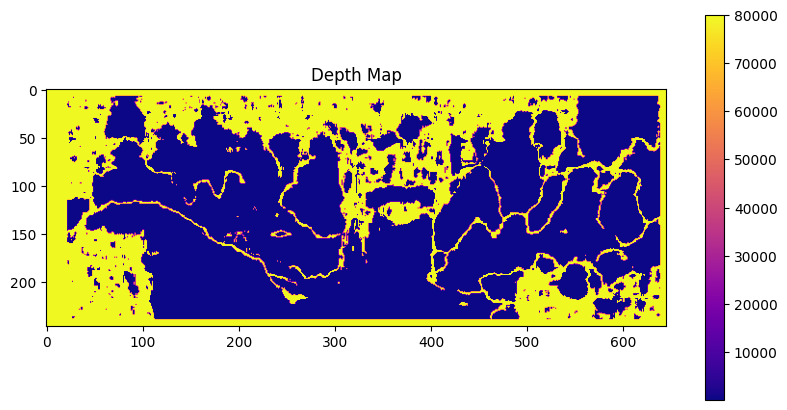

In [8]:
# Parameters
focal_length = 0.8          # Example value in meters
baseline = 0.1              # Distance between the two cameras in meters

# Avoid division by zero
disparity[disparity == 0] = 0.1
disparity[disparity == -1] = 0.1

# Depth calculation
################################################################################
# CODE HERE
depth_map = (focal_length * baseline) / (disparity + 0.000001)
################################################################################

plt.figure(figsize=(10, 5))
plt.imshow(depth_map, cmap='plasma')
plt.colorbar()
plt.title('Depth Map')
plt.show()

## Dense 3D Reconstruction (Optional - Visualization in 3D)

In [9]:
h, w = img_left.shape
f = focal_length # Focal length in pixels
Q = np.float32([[1, 0, 0, -w/2.0],
                [0, -1, 0, h/2.0],
                [0, 0, 0, -f],
                [0, 0, 1, 0]])

points_3D = cv2.reprojectImageTo3D(disparity, Q)
colors = cv2.cvtColor(cv2.imread(img_left_path), cv2.COLOR_BGR2RGB)
mask_map = disparity > disparity.min()
output_points = points_3D[mask_map]
output_colors = colors[mask_map]

In [10]:
%matplotlib notebook
# Create a pythreejs point cloud
point_cloud_geometry = p3js.BufferGeometry(
    attributes={
        'position': p3js.BufferAttribute(output_points.astype(np.float32), normalized=False),
        'color': p3js.BufferAttribute((output_colors / 255.0).astype(np.float32), normalized=False)
    }
)
material = p3js.PointsMaterial(vertexColors='VertexColors', size=0.05)
points = p3js.Points(geometry=point_cloud_geometry, material=material)

# Set up the scene
camera = p3js.PerspectiveCamera(position=[0, 0, 2], up=[0, 1, 0])
light = p3js.DirectionalLight(color='white', position=[3, 5, 1], intensity=0.6)
light.shadow = p3js.LightShadow(camera=p3js.OrthographicCamera(-5, 5, 5, -5, 0.1, 1000)) # Example shadow setup
light.target = points
scene = p3js.Scene(children=[points, camera, light, p3js.AmbientLight(intensity=0.5)], background=None)
renderer = p3js.Renderer(camera=camera, scene=scene, controls=[p3js.OrbitControls(controlling=camera)], width=800, height=600)

# Display the point cloud
display(renderer)

Renderer(camera=PerspectiveCamera(position=(0.0, 0.0, 2.0), projectionMatrix=(1.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.…

## DIY

Images: https://demo.ipol.im/demo/97/

Please do this again on your own with different images.

# 2. Rectifying Images for Easier Stereo Matching

### Visualization Code

In [11]:
%matplotlib inline

def get_cross_product_matrix(vector):
    '''
    The cross product of two vectors can be represented as a matrix multiplication.
    a x b = [a']b,
    where
    a = [a1, a2, a3] and
    a' = [[0, -a3, a2],
          [a3, 0, -a1],
          [-a2, a1, 0]]
    '''
    A = np.zeros((3, 3))
    a1, a2, a3 = vector
    A[0][1] = -a3
    A[0][2] = a2
    A[1][0] = a3
    A[1][2] = -a1
    A[2][0] = -a2
    A[2][1] = a1

    return A

def to_hg_coords(points):
    '''
    Convert the points from euclidean coordinates to homogeneous coordinates
    '''
    points = np.concatenate((points, np.ones((1, points.shape[1]))), axis=0)
    return points

def to_eucld_coords(points_hg):
    '''
    Convert the points from homogeneous coordinates to euclidean coordinates
    '''
    z = points_hg[-1,:]
    points = points_hg[:2,:]/z
    return points

def is_vectors_close(v1, v2):
    '''
    check if two vectors are close to each other
    '''
    v1 = v1.reshape(-1)
    v2 = v2.reshape(-1)
    assert len(v1) == len(v2)
    assert np.isclose(v1, v2).sum() == len(v1)

def plot_line(coeffs, xlim):
    '''
    Given the coefficients a, b, c of the ax + by + c = 0,
    plot the line within the given x limits.
    ax + by + c = 0 => y = (-ax - c) / b
    '''
    a, b, c = coeffs
    x = np.linspace(xlim[0], xlim[1], 100)
    y = (a * x + c) / -b
    return x, y

def show_matching_result(img1, img2, img1_pts, img2_pts):
    '''
    plot the images and their corresponding matching points
    '''
    fig = plt.figure(figsize=(8, 8))
    plt.imshow(np.hstack((img1, img2)), cmap="gray")
    for p1, p2 in zip(img1_pts, img2_pts):
        plt.scatter(p1[0], p1[1], s=35, edgecolors='r', facecolors='none')
        plt.scatter(p2[0] + img1.shape[1], p2[1], s=35, edgecolors='r', facecolors='none')
        plt.plot([p1[0], p2[0] + img1.shape[1]], [p1[1], p2[1]])
    plt.show()

### Fundamental Matrix

In [12]:
def compute_fundamental_matrix_normalized(points1, points2):
    '''
    Normalize points by calculating the centroid, subtracting
    it from the points and scaling the points such that the distance
    from the origin is sqrt(2)

    Parameters
    ------------
    points1, points2 - array with shape [n, 3]
        corresponding points in images represented as
        homogeneous coordinates
    '''
    # validate points
    assert points1.shape[0] == points2.shape[0], "no. of points don't match"

    # compute centroid of points
    c1 = np.mean(points1, axis=0)
    c2 = np.mean(points2, axis=0)

    # compute the scaling factor
    s1 = np.sqrt(2 / np.mean(np.sum((points1 - c1) ** 2, axis=1)))
    s2 = np.sqrt(2 / np.mean(np.sum((points2 - c2) ** 2, axis=1)))

    # compute the normalization matrix for both the points
    T1 = np.array([
        [s1, 0, -s1 * c1[0]],
        [0, s1, -s1 * c1[1]],
        [0, 0 ,1]
    ])
    T2 = np.array([
        [s2, 0, -s2 * c2[0]],
        [0, s2, -s2 * c2[1]],
        [0, 0, 1]
    ])

    # normalize the points
    points1_n = T1 @ points1.T
    points2_n = T2 @ points2.T

    # compute the normalized fundamental matrix
    F_n = compute_fundamental_matrix(points1_n.T, points2_n.T)

    # de-normalize the fundamental
    return T2.T @ F_n @ T1

def compute_fundamental_matrix(points1, points2):
    '''
    Compute the fundamental matrix given the point correspondences

    Parameters
    ------------
    points1, points2 - array with shape [n, 3]
        corresponding points in images represented as
        homogeneous coordinates
    '''
    # validate points
    assert points1.shape[0] == points2.shape[0], "no. of points don't match"

    u1 = points1[:, 0]
    v1 = points1[:, 1]
    u2 = points2[:, 0]
    v2 = points2[:, 1]
    one = np.ones_like(u1)

    # construct the matrix
    # A = [u2.u1, u2.v1, u2, v2.u1, v2.v1, v2, u1, v1, 1] for all the points
    # stack columns
    A = np.c_[u1 * u2, v1 * u2, u2, u1 * v2, v1 * v2, v2, u1, v1, one]

    # peform svd on A and find the minimum value of |Af|
    U, S, V = np.linalg.svd(A, full_matrices=True)
    f = V[-1, :]
    F = f.reshape(3, 3) # reshape f as a matrix

    # constrain F
    # make rank 2 by zeroing out last singular value
    U, S, V = np.linalg.svd(F, full_matrices=True)
    S[-1] = 0 # zero out the last singular value
    F = U @ np.diag(S) @ V # recombine again
    return F

def plot_epipolar_lines(img1, img2, points1, points2, show_epipole=False):
    '''
    Given two images and their corresponding points, compute the fundamental matrix
    and plot epipole and epipolar lines

    Parameters
    ------------
    img1, img2 - array with shape (height, width)
        grayscale images with only two channels
    points1, points2 - array with shape [n, 3]
        corresponding points in images represented as
        homogeneous coordinates
    show_epipole - boolean
        whether to compute and plot the epipole or not
    '''

    # get image size
    h, w = img1.shape
    n = points1.shape[0]
    # validate points
    if points2.shape[0] != n:
        raise ValueError("No. of points don't match")

    # compute the fundamental matrix
    F = compute_fundamental_matrix_normalized(points1, points2)

    # configure figure
    nrows = 2
    ncols = 1
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6, 8))

    # plot image 1
    ax1 = axes[0]
    ax1.set_title("Image 1")
    ax1.imshow(img1, cmap="gray")

    # plot image 2
    ax2 = axes[1]
    ax2.set_title("Image 2")
    ax2.imshow(img2, cmap="gray")

    # plot epipolar lines
    for i in range(n):
        p1 = points1.T[:, i]
        p2 = points2.T[:, i]

        # Epipolar line in the image of camera 1 given the points in the image of camera 2
        coeffs = p2.T @ F
        x, y = plot_line(coeffs, (-1500, w)) # limit hardcoded for this image. please change
        ax1.plot(x, y, color="orange")
        ax1.scatter(*p1.reshape(-1)[:2], color="blue")

        # Epipolar line in the image of camera 2 given the points in the image of camera 1
        coeffs = F @ p1
        x, y = plot_line(coeffs, (0, 2800)) # limit hardcoded for this image. please change
        ax2.plot(x, y, color="orange")
        ax2.scatter(*p2.reshape(-1)[:2], color="blue")

    if show_epipole:
        # compute epipole
        e1 = compute_epipole(F)
        e2 = compute_epipole(F.T)
        # plot epipole
        ax1.scatter(*e1.reshape(-1)[:2], color="red")
        ax2.scatter(*e2.reshape(-1)[:2], color="red")
    else:
        # set axes limits
        ax1.set_xlim(0, w)
        ax1.set_ylim(h, 0)
        ax2.set_xlim(0, w)
        ax2.set_ylim(h, 0)

    plt.tight_layout()

def compute_epipole(F):
    '''
    Compute epipole using the fundamental matrix.
    pass F.T as argument to compute the other epipole
    '''
    U, S, V = np.linalg.svd(F)
    e = V[-1, :]
    e = e / e[2]
    return e

def compute_matching_homographies(e2, F, im2, points1, points2):
    '''
    Compute the matching homography matrices
    '''
    h, w = im2.shape
    # create the homography matrix H2 that moves the epipole to infinity

    # create the translation matrix to shift to the image center
    T = np.array([[1, 0, -w/2], [0, 1, -h/2], [0, 0, 1]])
    e2_p = T @ e2
    e2_p = e2_p / e2_p[2]
    e2x = e2_p[0]
    e2y = e2_p[1]
    # create the rotation matrix to rotate the epipole back to X axis
    if e2x >= 0:
        a = 1
    else:
        a = -1
    R1 = a * e2x / np.sqrt(e2x ** 2 + e2y ** 2)
    R2 = a * e2y / np.sqrt(e2x ** 2 + e2y ** 2)
    R = np.array([[R1, R2, 0], [-R2, R1, 0], [0, 0, 1]])
    e2_p = R @ e2_p
    x = e2_p[0]
    # create matrix to move the epipole to infinity
    G = np.array([[1, 0, 0], [0, 1, 0], [-1/x, 0, 1]])
    # create the overall transformation matrix
    H2 = np.linalg.inv(T) @ G @ R @ T

    # create the corresponding homography matrix for the other image
    e_x = np.array([[0, -e2[2], e2[1]], [e2[2], 0, -e2[0]], [-e2[1], e2[0], 0]])
    M = e_x @ F + e2.reshape(3,1) @ np.array([[1, 1, 1]])
    points1_t = H2 @ M @ points1.T
    points2_t = H2 @ points2.T
    points1_t /= points1_t[2, :]
    points2_t /= points2_t[2, :]
    b = points2_t[0, :]
    a = np.linalg.lstsq(points1_t.T, b, rcond=None)[0]
    H_A = np.array([a, [0, 1, 0], [0, 0, 1]])
    H1 = H_A @ H2 @ M
    return H1, H2

## Plot Images and Matching Points

For convenience, let's use already extracted keypoint features.

In [13]:
# load images
im1 = io.imread(os.path.join(base_path, "bench_right.png"))
im1 = rgb2gray(rgba2rgb(im1))
im2 = io.imread(os.path.join(base_path, "bench_left.png"))
im2 = rgb2gray(rgba2rgb(im2))

# load matching points
points1 = np.load(os.path.join(base_path, "bench_right_points.npy"))
points2 = np.load(os.path.join(base_path, "bench_left_points.npy"))

assert (points1.shape == points2.shape)

##### Plot matching points

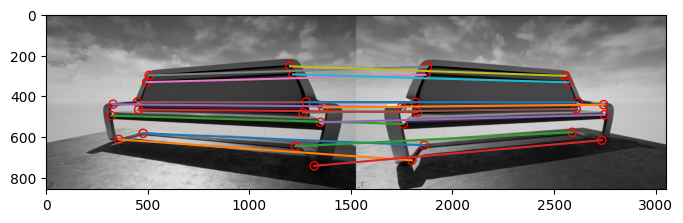

In [14]:
show_matching_result(im1, im2, points1, points2)

## The Fundamental Matrix

In [15]:
# compute the normalized fundamental matrix
F = compute_fundamental_matrix_normalized(points1, points2)

In [16]:
# validate the fundamental matrix equation
p1 = points1.T[:, 0]
p2 = points2.T[:, 0]

np.round(p2.T @ F @ p1)

0.0

### Plot Epipolar lines

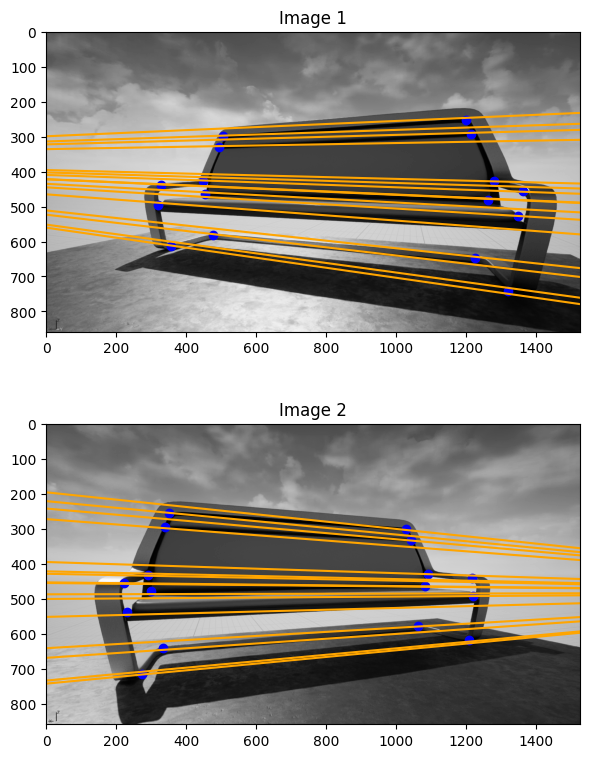

In [17]:
plot_epipolar_lines(im1, im2, points1, points2, show_epipole=False)

### Plot Epipoles

In [18]:
e1 = compute_epipole(F)
e2 = compute_epipole(F.T)

In [19]:
# validate fundamental matrix equation for epipoles
np.round(e2.T @ F @ e1)

0.0

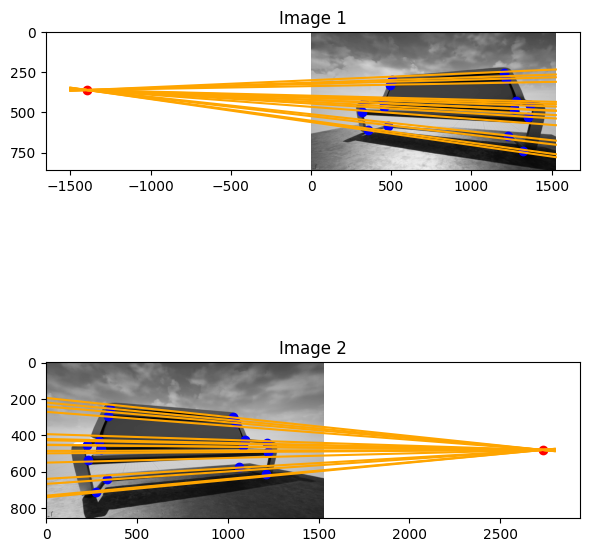

In [20]:
plot_epipolar_lines(im1, im2, points1, points2, show_epipole=True)

## Stereo rectification

In [21]:
H1, H2 = compute_matching_homographies(e2, F, im2, points1, points2)

In [22]:
# Transform points based on the homography matrix
new_points1 = H1 @ points1.T
new_points2 = H2 @ points2.T
new_points1 /= new_points1[2,:]
new_points2 /= new_points2[2,:]
new_points1 = new_points1.T
new_points2 = new_points2.T

# warp images based on the homography matrix
im1_warped = warp(im1, ProjectiveTransform(matrix=np.linalg.inv(H1)))
im2_warped = warp(im2, ProjectiveTransform(matrix=np.linalg.inv(H2)))

##### Plot the new epipolar lines and matching points

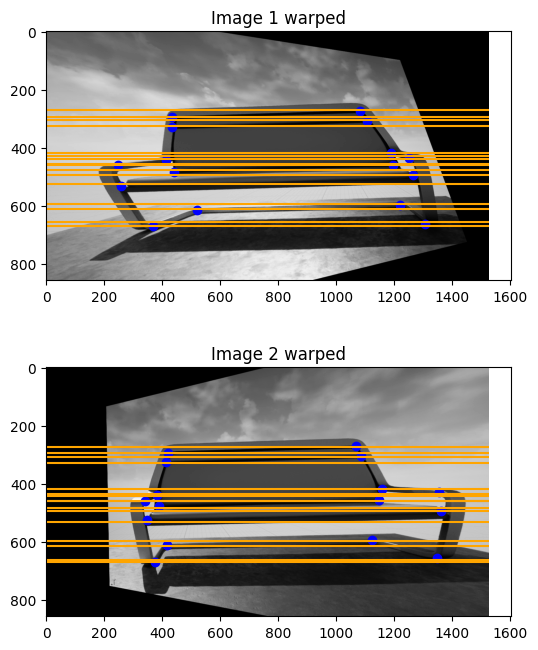

In [23]:
h, w = im1.shape

nrows = 2
ncols = 1
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(6, 8))

# plot image 1
ax1 = axes[0]
ax1.set_title("Image 1 warped")
ax1.imshow(im1_warped, cmap="gray")

# plot image 2
ax2 = axes[1]
ax2.set_title("Image 2 warped")
ax2.imshow(im2_warped, cmap="gray")

# plot the epipolar lines and points
n = new_points1.shape[0]
for i in range(n):
    p1 = new_points1[i]
    p2 = new_points2[i]

    ax1.hlines(p2[1], 0, w, color="orange")
    ax1.scatter(*p1[:2], color="blue")

    ax2.hlines(p1[1], 0, w, color="orange")
    ax2.scatter(*p2[:2], color="blue")

# 3. Volumetric Surface Reconstruction

Volumetric Surface Reconstruction (VSF) is a subset of multiview stereo reconstruction that recreates a continuous 3D surface using 2D images.

## Overview

1. Acquire a dataset with multiple views of the target structure. The dataset should also include images and projection matrixes for all images.  

2. Create silhouettes for all images using an appropriate segmentation method

3. Create visual hull using silhouettes of all images.

4. Create a volumetric graph of the visual hull with edges weights based on photo-consistency.

5. Perform graph cuts to obtain the final 3D structure

## Data

For simplicity, existing datasets captured using the Stanford Spherical Gantry were used, the data is provided by Steve Seitz, James Diebel, Daniel Scharstein and Rick Szeliski of Univesity of Washington, Stanford University, Middlebury College and Microsoft Research respectively.

There are datasets for two structures:
1. Dinosaur
2. Temple

The following code loads the data and stores it as an instance of Data class.

In [24]:
class Data:
    def __init__(self, base_path, data_set):
        self.base_path = base_path
        self.data_set = data_set
        self.init_bounding_box()
        self.load_camera_info()

    def init_bounding_box(self):
        bounding_boxes = {
            'dinoSR': {
                'x': np.array([-0.07, 0.02]),
                'y': np.array([-0.02, 0.07]),
                'z': np.array([-0.07, 0.02])
            },
            'dinoR': {
                'x': np.array([-0.03, 0.06]),
                'y': np.array([-0.022, 0.11]),
                'z': np.array([-0.02, 0.06])
            },
            'templeSR': {
                'x': np.array([-0.08, 0.03]),
                'y': np.array([0.0, 0.18]),
                'z': np.array([-0.02, 0.06])
            }
        }
        self.bounding_box = bounding_boxes[self.data_set]

    def load_camera_info(self):

        # Dictionary of data_sets with image_paths
        image_paths = {
            'dinoSR': 'dinoSparseRing/',
            'dinoR': 'dinoRing/',
            'templeSR': 'templeSparseRing/'
        }

        # Open file in read mode
        path = image_paths[self.data_set]
        fp = open(os.path.join(base_path, path, self.data_set+'_par.txt'), 'r')

        num_images = int(fp.readline())
        self.size = num_images

        P = []           # projection matrices
        T = []           # camera positions
        imgs = []        # images

        for i in range(num_images):
            raw_info = fp.readline().split()
            img_name = raw_info[0]
            raw_info = list(map(float, raw_info[1:]))

            # Projection Matrix of the camera
            K = np.array(raw_info[0:9]).reshape(3,3)
            R = np.array(raw_info[9:18]).reshape(3,3)
            t = np.array(raw_info[18:])
            Rt = np.stack((R[:,0], R[:,1], R[:,2], t), axis=1)
            P.append(np.matmul(K, Rt))

            # Position of camera is Translation vector
            T.append(t)

            # Read Image and store
            img = plt.imread(os.path.join(base_path, path, img_name))
            imgs.append(img)

        self.P = np.array(P)
        self.T = np.array(T)
        self.imgs = np.array(imgs)

    def display_dataset(self, silhouettes=False):
        plt.figure()
        r = self.size // 4

        for i in range(self.size):
            plt.subplot(r,4,i+1)
            if silhouettes:
                plt.imshow(self.sils[i])
            else:
                plt.imshow(self.imgs[i])
        plt.show()

    def sample_image(self):
        return self.imgs[np.random.randint(self.size)]

    def init_silhouttes(self, Segment):
        sils = []        # silhouettes

        for img in self.imgs:
            # create silhouttes using segmentation method
            sil = Segment(img).run()
            sils.append(sil)

        self.sils = np.array(sils)

### Dinosaur

The dinosaur dataset has 16 images taken from different viewing angle using Stanford Spherical Gantry.

Image shape:  (480, 640, 3)


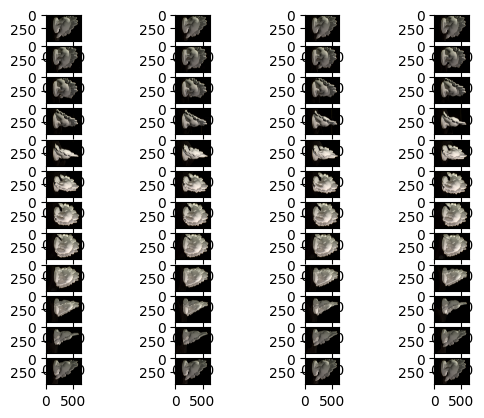

In [25]:
dino = Data(base_path, 'dinoR')

print("Image shape: ", dino.imgs[0].shape)

dino.display_dataset()

### Dataset Temple

The temple dataset also has 16 images taken from different viewing angle using Stanford Spherical Gantry.

Image shape:  (480, 640, 3)


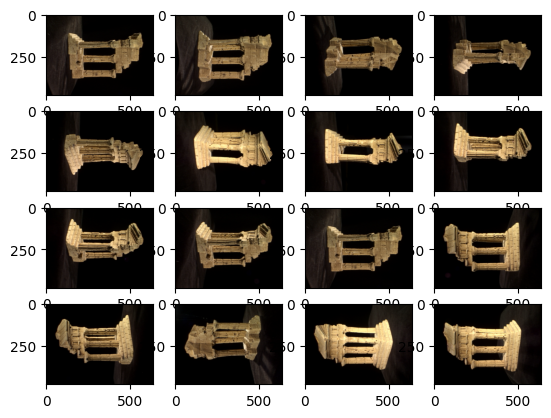

In [37]:
################################################################################
# CODE HERE
temple = Data(base_path, 'templeSR')
print("Image shape: ", temple.imgs[0].shape)
temple.display_dataset()
################################################################################

## Segmentation

The following plots show histogram distribution of temple and dinosaur dataset

In [26]:
def plot_intensity_histogram(img):
    plt.figure()
    for i in range(img.shape[2]):
        plt.subplot(1,3,i+1)
        plt.hist(img[:,:,i].flatten())
    plt.show()

### Dinosaur image histogram

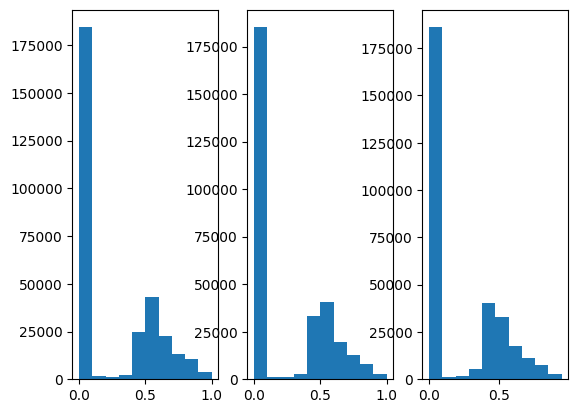

In [27]:
plot_intensity_histogram(dino.sample_image())

### Temple Image Histogram

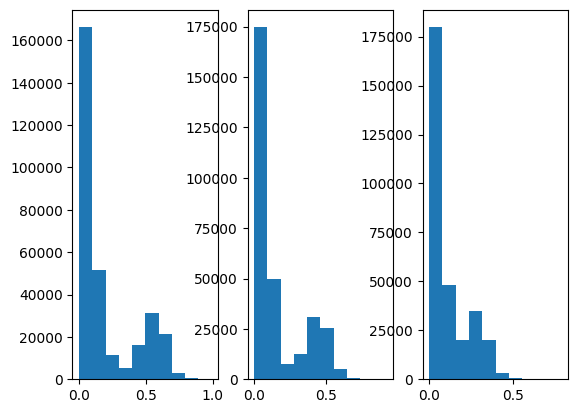

In [38]:
################################################################################
# CODE HERE
plot_intensity_histogram(temple.sample_image())
################################################################################

Since the background has low intensity and target object has high intensity,  a simple threshold segmentation can do quite a good job for creating silhouettes.

## Threshold Segmentation

From the given histogram and trial and error, a threshold value of 0.04 was selected for both dataset. As threshold value increased the segmentation got better but some pixels from target structure were classifies as background. To avoid such gaps, a lower threshold vaue was picked.

The background pixels that are included in the target object will make visual hull slightly bulkier. However, that part will be removed during volumetric graph cuts of visual hull.

In [28]:
class ThresholdSegment:
    def __init__(self, image, threshold=0.05):
        self.image = image
        self.threshold = threshold

    def run(self):
        sil = np.zeros((self.image.shape[0], self.image.shape[1]))
        sil[np.where(self.image > self.threshold)[:2]] = 1
        return sil


### Dinosaur Silhouettes

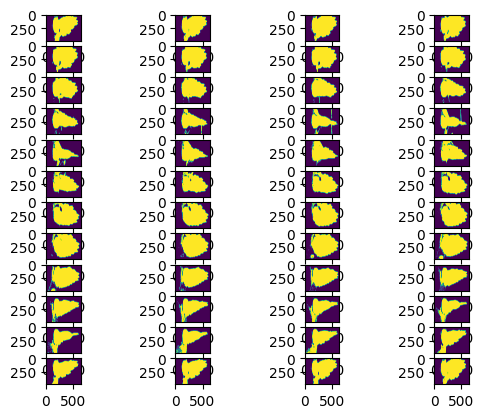

In [29]:
dino.init_silhouttes(ThresholdSegment)
dino.display_dataset(silhouettes=True)

### Temple Silhouettes

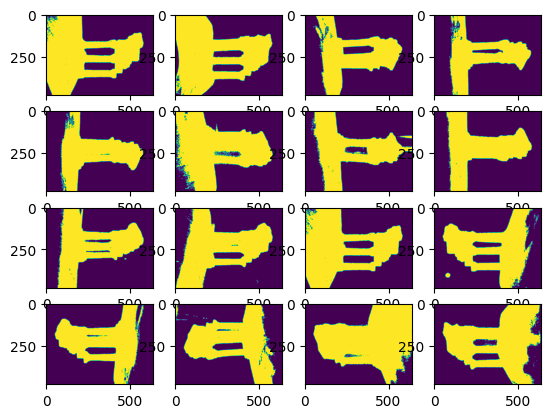

In [39]:
################################################################################
# CODE HERE
temple.init_silhouttes(ThresholdSegment)
temple.display_dataset(silhouettes=True)
################################################################################

## Other Segmentation Methods

Alternatively, we could also perform k-means superpixels or semi-supervised like interactive graph-cuts for datasets that cannot be segmented using threshold segmenting. This was out of scope for a single person project and is thus not done here.

## Visual Hull

A visual hull is a geometric entity created by shape-from-silhouette 3D reconstruction technique. The technique used here is intersection of cones.

The following steps describe an overview of the process:
1. Project each camera's silhouette into space to obtain a 3D cone
2. The intersection of the cones generated by each image gives the visual hull of the object.

In other words, visual hull is the smallest 3D shape consistent with all silhouettes.

The algorithm for creating visual hull used is described below:
1. Create a bounding cuboid structure and initialize it with voxels of some size.
2. Initialize all the voxels with a value 1.
3. For each camera position:<br>
    3.1 Project all voxels in cuboid to the image using Projection matrix -> $P_i = K_i[R_i | T_i]$ <br>
    3.2 Change values of all voxels from 1 to 0 that are not projected on the camera silhouette $S_i$
4. Create a grid the update voxel_list
5. Plot the voxel grid

In [30]:
class Voxel:
    def __init__(self, args):
        self.x = args[0]
        self.y = args[1]
        self.z = args[2]
        self.val = args[3]

    # Prints details about the voxel
    def log(self):
        print("\tx: ", self.x)
        print("\ty: ", self.y)
        print("\tz: ", self.z)
        print("\tval: ", self.val)

    # Returns homogeneous coordinates of the voxel
    def homo(self):
        return np.array([self.x, self.y, self.z, 1]).reshape(4, 1)

class VisualHull:
    def __init__(self,
                 data,
                 voxel_size=np.array([0.002, 0.002, 0.002])):

        self.data = data
        self.voxel_size = voxel_size

        self.sils = self.data.sils
        self.P = self.data.P

        self.img_height = self.data.imgs.shape[1]
        self.img_width = self.data.imgs.shape[2]

    def initialize_voxels(self, xlim, ylim, zlim):
        # Determine shape of visual hull grid
        hull_shape = np.zeros(3)
        hull_shape[0] = abs(xlim[1] - xlim[0])/self.voxel_size[0]
        hull_shape[1] = abs(ylim[1] - ylim[0])/self.voxel_size[1]
        hull_shape[2] = abs(zlim[1] - zlim[0])/self.voxel_size[2]
        self.hull_shape = hull_shape + np.ones(3)

        # Compute total voxels using grid shape
        self.total_voxels = np.prod(self.hull_shape)

        # List storing (x, y, z, val) of each voxel
        self.voxels2D_list = np.ones((int(self.total_voxels), 4), float)

        # Compute increment and decrement step direction
        sx = xlim[0]
        ex = xlim[1]
        sy = ylim[0]
        ey = ylim[1]
        sz = zlim[0]
        ez = zlim[1]

        if ex > sx:
            x_step = self.voxel_size[0]
        else:
            x_step = -self.voxel_size[0]

        if ey > sy:
            y_step = self.voxel_size[1]
        else:
            y_step = -self.voxel_size[1]

        if ez > sz:
            z_step = self.voxel_size[2]
        else:
            z_step = -self.voxel_size[2]

        self.x_step = x_step
        self.y_step = y_step
        self.z_step = z_step

        x_linspace = np.linspace(sx, ex, int(self.hull_shape[0]))
        y_linspace = np.linspace(sy, ey, int(self.hull_shape[1]))
        z_linspace = np.linspace(sz, ez, int(self.hull_shape[2]))

        # Initialize voxel list
        l = 0
        for z in z_linspace:
            for x in x_linspace:
                for y in y_linspace:
                    self.voxels2D_list[l, 0:3] = np.array([x, y, z])
                    l = l+1

    def create_visual_hull(self):

        # Homogeneous 3D world coordinates
        object_points3D_homo = np.transpose(self.voxels2D_list)

        # Iterate through each camera position
        # print("Processing frames: ")
        for i in range(self.P.shape[0]):
            # print(i+1, " ",)

            # Homogeneous image coordinate for camera/image i
            points2D_homo = np.matmul(self.P[i], object_points3D_homo)

            # Remove infinity points
            inf_ind = np.where(points2D_homo[2] == 0)
            points2D_homo[:, inf_ind] = 1

            # Image coordinates
            points2D = np.divide(points2D_homo[0:2], [points2D_homo[2], points2D_homo[2]]);

            # Remove points outside image boundary
            ind_x_lt_0 = np.where(points2D[0] < 0)
            ind_y_lt_0 = np.where(points2D[1] < 0)
            ind_x_gt_w = np.where(points2D[0] >= self.img_width)
            ind_y_gt_h = np.where(points2D[1] >= self.img_height)
            points2D[:, ind_x_lt_0] = 1
            points2D[:, ind_y_lt_0] = 1
            points2D[:, ind_x_gt_w] = 1
            points2D[:, ind_y_gt_h] = 1

            # Make voxel value 0 for those not being projected
            ind = np.ravel_multi_index(
                (points2D[1,:].astype(int), points2D[0,:].astype(int)),
                dims=(self.img_height, self.img_width), order='C')
            cur_sil = self.data.sils[i]
            img_val = cur_sil.ravel()[ind]
            zero_ind = np.where(img_val == 0)[0]

            # Update list of voxels
            self.voxels2D_list[zero_ind, 3] = 0

    def create_grids(self):
        # Initialize Grids - one with all voxel info, one just with voxel values
        self.voxel3D = np.zeros([int(self.hull_shape[1]), int(self.hull_shape[0]), int(self.hull_shape[2])], dtype=float)
        self.visual_hull = np.zeros([int(self.hull_shape[1]), int(self.hull_shape[0]), int(self.hull_shape[2])], dtype=object)

        # Assign values in 3D grid
        l=0
        for zi in range(self.voxel3D.shape[2]):
            for xi in range(self.voxel3D.shape[1]):
                for yi in range(self.voxel3D.shape[0]):
                    self.voxel3D[yi, xi, zi] = self.voxels2D_list[l, 3]
                    self.visual_hull[yi, xi, zi] = Voxel(self.voxels2D_list[l,:])
                    l = l+1

    def plot_marching_cube(self, vis='rendering'):
        assert vis in ['rendering', '3D']
        # Display resulting triangular mesh using Matplotlib.
        verts, faces, normals, values = measure.marching_cubes(self.voxel3D.T, 0)

        if vis == 'rendering':
            fig = plt.figure()
            ax = fig.add_subplot(111, projection='3d')

            # Fancy indexing: `verts[faces]` to generate a collection of triangles
            mesh = Poly3DCollection(verts[faces])
            mesh.set_edgecolor('k')
            ax.add_collection3d(mesh)

            ax.set_xlabel("x-axis")
            ax.set_ylabel("y-axis")
            ax.set_zlabel("z-axis")

            ax.set_xlim(0, self.voxel3D.T.shape[0]) # a = 6 (times two for 2nd ellipsoid)
            ax.set_ylim(0, self.voxel3D.T.shape[1]) # b = 10
            ax.set_zlim(0, self.voxel3D.T.shape[2]) # c = 16

            plt.tight_layout()
            plt.show()
        elif vis == '3D':
            # Create a 3D mesh using Plotly
            fig = go.Figure(data=[
                go.Mesh3d(
                    x=verts[:, 0],
                    y=verts[:, 1],
                    z=verts[:, 2],
                    i=faces[:, 0],
                    j=faces[:, 1],
                    k=faces[:, 2],
                    color='lightpink',
                    opacity=0.50
                )
            ])

            # Update the layout for better visualization
            fig.update_layout(
                scene=dict(
                    xaxis=dict(nticks=10, range=[0, self.voxel3D.T.shape[0]], title="x-axis"),
                    yaxis=dict(nticks=10, range=[0, self.voxel3D.T.shape[1]], title="y-axis"),
                    zaxis=dict(nticks=10, range=[0, self.voxel3D.T.shape[2]], title="z-axis")
                ),
                width=700,
                margin=dict(r=20, l=10, b=10, t=10)
            )

            fig.show()

    def run(self):
        print("Initializing Voxels ->")
        self.initialize_voxels(
            self.data.bounding_box['x'],
            self.data.bounding_box['y'],
            self.data.bounding_box['z'])
        print("Forming Visual Hull ->")
        self.create_visual_hull()
        print("-> Creating 3D grids ->")
        self.create_grids()
        print("Plotting marching cubes ... ")
        self.plot_marching_cube('3D')


### Voxel Sizes

Visual Hulls for two different voxel sizes for each dataset were created for comparision, the smaller the voxel dimensions the higher is the resolution of visual hull.

Due to limitations in computing power, the resolution of the 3D structure was kept low.

Note: The 3D plots don't have shadows so they might not show enough detail in images, I would recommend to run the notebook and rotate the structures to see better results.

In [31]:
big_voxels = [0.003, 0.003, 0.003]
med_voxels = [0.002, 0.002, 0.002]
small_voxels = [0.001, 0.001, 0.001]

### Dino Visual Hull

Appendix A provides multiple rotation of the Dino Visual Hull

#### Low resolution (med voxels)

In [32]:
dino_hull_lr = VisualHull(dino, np.array(med_voxels))
dino_hull_lr.run()

Initializing Voxels ->
Forming Visual Hull ->
-> Creating 3D grids ->
Plotting marching cubes ... 


#### High resolution (small voxels)

In [33]:
dino_hull_hr = VisualHull(dino, np.array(small_voxels))
dino_hull_hr.run()

Initializing Voxels ->
Forming Visual Hull ->
-> Creating 3D grids ->
Plotting marching cubes ... 


### Temple Visual Hull

Appendix B provides multiple rotation of the Temple Visual Hull

#### Low Resolution (big voxels)

In [40]:
################################################################################
# CODE HERE
temple_hull_lr = VisualHull(temple, np.array(med_voxels))
temple_hull_lr.run()
################################################################################

Initializing Voxels ->
Forming Visual Hull ->
-> Creating 3D grids ->
Plotting marching cubes ... 


#### High Resolution (med voxels)

In [41]:
################################################################################
# CODE HERE
temple_hull_hr = VisualHull(temple, np.array(small_voxels))
temple_hull_hr.run()
################################################################################

Initializing Voxels ->
Forming Visual Hull ->
-> Creating 3D grids ->
Plotting marching cubes ... 


## Volumetric Graph Cuts

The 3D structure can be further refined using volumetric graph-cuts via photo-consistency.

### Photo Consistency Metric

Photo-consistency, $\rho$, of a scene point, $x$, can be evaluated by comparing its projections in the images where it is visible. Variance of pixel intensities was used as a comparison parameter in this project.

$$ \rho(x) = \Sigma \; {|I_i - I_{avg}|}^2 $$

where,<br>
$x$ is scene point location in 3D<br>
$I$ is intensity of pixel $i$ (RGB values)<br>
$I_{avg}$ is the average intensity

For the purpose of the project, only the projections of a scene point on its closest k cameras were considered visible. This is not always true, but the complexity of code increases significantly if we want to find all visible projections of scene point. So, to avoid complications, it was not pursued

### Graph Structure

This graph structure was partially borrowed from "Multiview Stereo via Volumetric Graph-Cuts and Occlusion Robust Photo-Consistency" paper written by George Vogiatzis, Carlos Hernandez, Philip Torr, and Roberto Cipolla.

#### Node
The node of the graphs represents active voxels in the visual hull. Each node is connected to 6 neighbouring nodes (neighbouring voxels location based) through an n-link. The six neighbours are left, right, top, bottom, front and back.

#### N-Links (Edges)
The weight, $W_n$, of an n-link edge is a function of photo-consistency of the edge. The scene point position of the edge used for photo-consistency metric is the midpoint of two voxel location the edge is connecting.

$$ W_n(e) = \frac{4 \pi h^2}{3}\rho\left(\frac{x_i + x_j}{2}\right) $$

where, <br>
$h$ is size of voxel<br>
$x_i$ is location of first voxel connected to the edge $e$<br>
$x_j$ is location of second voxel connected to the edge $e$<br>

Note: We can improve the weight function for n-links using robust techniques such as saturation of weights above a certain value. This emulates a truncated quadratic function since $\rho$ is quadratic.

#### T-links (Sink)
All the voxels exposed to the surface of visual hull were connected to sink with an $\infty$ weight.

#### T-links (Source)
All the non-surface voxels in visual hull are connected to the source using weight $W_b$

$$ W_b = \lambda h^3 $$

where, <br>
$h$ is size of voxel<br>
$\lambda$ is a hyper parameter to tune graph-cuts

#### Optimization

Graph cuts are done using maxflow/minimum-cut algorithm. PyMaxFlow was used to create a graph and perform graph-cuts using maxflow algorithm.

In [34]:
class VolumetricGraphCuts:

    def __init__(self, data, visual_hull, k=4, _lambda=10e6):

        # Initialize Visual Hull
        self.hull = visual_hull.visual_hull
        self.init_hull_surf()
        self.voxel_size = visual_hull.voxel_size
        self.voxel_list = visual_hull.voxels2D_list

        # Initialize Camera/Image data
        self.data = data
        self.T = self.data.T
        self.P = self.data.P
        self.imgs = self.data.imgs

        self.img_height = self.data.imgs.shape[1]
        self.img_width = self.data.imgs.shape[2]


        # Initialize Hyper parameters
        self.k = k
        self._lambda = _lambda

        print("Initializing Graph ...")
        self.init_graph(debug=True)
        print("done")

    def init_hull_surf(self):
        # Visual hull with only surface values
        self.hull_surf = np.zeros(self.hull.shape, float)
        for y in range(self.hull.shape[0]):
            for x in range(self.hull.shape[1]):
                for z in range(self.hull.shape[2]):
                    if self.hull[y,x,z].val == 1:
                        self.hull_surf[y,x,z] = 1
                        if x > 0 and x < self.hull.shape[1]-1 and (self.hull[y, x-1, z].val == 0 or self.hull[y, x+1, z].val == 0):
                            self.hull_surf[y,x,z] = 2
                        if y > 0 and y < self.hull.shape[0]-1 and (self.hull[y-1, x, z].val == 0 or self.hull[y+1, x, z].val == 0):
                            self.hull_surf[y,x,z] = 2
                        if z > 0 and z < self.hull.shape[2]-1 and (self.hull[y, x, z-1].val == 0 or self.hull[y, x, z+1].val == 0):
                            self.hull_surf[y,x,z] = 2

    def init_graph(self, debug=False):
        # Initialize Graph
        if debug:
            print("\tGraph ->")
        self.graph = maxflow.GraphFloat()
        if debug:
            print("created")

        if debug:
            print("\tNodes ->")

        print(self.hull_surf.shape)
        self.node_ids = self.graph.add_grid_nodes(self.hull_surf.shape)

        if debug:
            print("added")

        if debug:
            print("\tT-links ->")
        self.add_sink_edges()
        if debug:
            print("sink done ->")
        self.add_source_edges()
        if debug:
            print("source done")

        if debug:
            print("\tN-links ->")
        self.add_n_links()
        if debug:
            print("done")

    def add_sink_edges(self):
        surf_inds = self.node_ids[np.where(self.hull_surf == 2)]

        # Add t-link with inf weight to surface nodes
        for ind in surf_inds:
            self.graph.add_tedge(ind, 0, float('inf'))

    def add_source_edges(self):
        non_surf_inds = self.node_ids[np.where(self.hull_surf == 1)]

        # Add t-link of weight lambda * h^3 to all nodes that are not on surface
        self.Wb = self._lambda * np.prod(self.voxel_size)

        for ind in non_surf_inds:
            self.graph.add_tedge(ind, self.Wb, 0)

    def photo_consistency(self, world_coord):
        d = []
        for t in self.T:
            d.append(np.linalg.norm(world_coord[:3]+t))
        inds = np.argsort(d)[:self.k]

        intensities = []
        for i in inds:
            img_coord = np.matmul(self.P[i], world_coord)

            # Skip if infinity point
            if img_coord[2] == 0:
                continue

            # Image coordinates
            img_coord = np.divide(img_coord[0:2], [img_coord[2], img_coord[2]]);

            # Skip points outside image boundary
            if (img_coord[0] < 0 or img_coord[0] >= self.img_width):
                continue
            if (img_coord[1] < 0 or img_coord[1] >= self.img_height):
                continue

            intensities.append(self.imgs[i, int(img_coord[1]), int(img_coord[0])])

        intensities = np.array(intensities)
        avg_I = np.mean(intensities, axis=0)

        pc = 0
        for I in intensities:
            pc += sqrt((I[0] - avg_I[0])**2 + (I[1] - avg_I[1])**2 + (I[2] - avg_I[2])**2)**2

        return pc


    def add_n_links(self, debug=False):
        def midpoint(p1, p2):
            return (p1 + p2)/2.0

        def valid_neighbour(ind):
            return ind[0] >= 0 and ind[1] >= 0 and ind[2] >= 0 and self.hull[ind].val == 1

        inds = np.where(self.hull_surf > 0)
        self.weights = np.zeros((inds[0].shape[0], 6), float)
        nu = (4*np.pi*(self.voxel_size[0]**2))/3.0

        for j in range(inds[0].shape[0]):
            x = inds[1][j]
            y = inds[0][j]
            z = inds[2][j]
            self.weights[j, :3] = self.hull[y,x,z].homo()[:3, 0]
            vox_ind = self.node_ids[y,x,z]
            vox = self.hull[y,x,z]

            neighbours = [(y, x-1, z), (y-1, x, z), (y, x, z-1)]

            for i,neighbour in enumerate(neighbours):
                if valid_neighbour(neighbour):
                    neigh_ind = self.node_ids[neighbour]
                    neigh_vox = self.hull[neighbour]
                    edge_coord = midpoint(vox.homo(), neigh_vox.homo())
                    W = nu * self.photo_consistency(edge_coord)
                    self.graph.add_edge(vox_ind, neigh_ind, W, W)
                    self.weights[j, i+3] = W

    def create3D_structure(self):
        count_rm=0
        count_st=0
        self.structure3D = np.zeros(self.hull.shape, float)
        for z in range(self.hull.shape[2]):
            for x in range(self.hull.shape[1]):
                for y in range(self.hull.shape[0]):
                    if self.hull[y,x,z].val == 0:
                        self.structure3D[y,x,z] = 0
                    else:
                        node_id = self.node_ids[y,x,z]

                        if self.graph.get_segment(node_id) == 0:
                            self.structure3D[y,x,z] = 1
                            count_st += 1
                        else:
                            self.structure3D[y,x,z] = 0
                            count_rm += 1
        print("\tVoxels in visual hull: ", count_st+count_rm)
        print("\tNumber of voxels removed during graph-cuts: ", count_rm)
        print("\tVoxels in final result: ", count_st)


    def plot3D_structure(self, vis='rendering'):
        assert vis in ['rendering', '3D']
        # Display resulting triangular mesh using Matplotlib.
        # verts, faces, normals, values = measure.marching_cubes(self.voxel3D.T, 0)
        verts, faces, normals, values = measure.marching_cubes(self.structure3D.T, 0)

        if vis == 'rendering':
            fig = plt.figure()
            ax = fig.add_subplot(111, projection='3d')

            # Fancy indexing: `verts[faces]` to generate a collection of triangles
            mesh = Poly3DCollection(verts[faces])
            mesh.set_edgecolor('k')
            ax.add_collection3d(mesh)

            ax.set_xlabel("x-axis")
            ax.set_ylabel("y-axis")
            ax.set_zlabel("z-axis")

            ax.set_xlim(0, self.structure3D.T.shape[0]) # a = 6 (times two for 2nd ellipsoid)
            ax.set_ylim(0, self.structure3D.T.shape[1]) # b = 10
            ax.set_zlim(0, self.structure3D.T.shape[2]) # c = 16

            plt.tight_layout()
            plt.show()
        elif vis == '3D':
            # Create a 3D mesh using Plotly
            fig = go.Figure(data=[
                go.Mesh3d(
                    x=verts[:, 0],
                    y=verts[:, 1],
                    z=verts[:, 2],
                    i=faces[:, 0],
                    j=faces[:, 1],
                    k=faces[:, 2],
                    color='lightpink',
                    opacity=0.50
                )
            ])

            # Update the layout for better visualization
            fig.update_layout(
                scene=dict(
                    xaxis=dict(nticks=10, range=[0, self.structure3D.T.shape[0]], title="x-axis"),
                    yaxis=dict(nticks=10, range=[0, self.structure3D.T.shape[1]], title="y-axis"),
                    zaxis=dict(nticks=10, range=[0, self.structure3D.T.shape[2]], title="z-axis")
                ),
                width=700,
                margin=dict(r=20, l=10, b=10, t=10)
            )

            fig.show()

    def plot_voxels(self):
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.voxels(self.structure3D, facecolors='red', edgecolor='k')

        plt.show()

    def run(self):
        print("Running MaxFlow ->")
        self.graph.maxflow()
        print("done")

        print("Create 3D Structure from graph ...")
        self.create3D_structure()
        print("done")

        print("Plot final result ->")
        self.plot3D_structure('3D')
        print("done")

### Results

As shown, we have a very good 3D representation of the target structure.

Each 3D plot shows the number of voxels that were removed from the visual hull when graph-cuts was performed. This showed that the graph-cuts performed as intended, as the result is an improved the 3D representation of visual hull.

#### Dino Results

The the graph cuts was performed on low resolution dino visual hull. Note that the neck of dinosaur is quite visible now that graph cuts has been performed. In visual hull, the neck wasn't defined this well.

It can be seen from the logs that total of $4298$ voxels were removed from visual hull when graphs cut was performed. Visual hull initially had $16323$ voxels, and resulting structure had $12025$ voxels.

In [35]:
dino_cut = VolumetricGraphCuts(dino, dino_hull_lr)

Initializing Graph ...
	Graph ->
created
	Nodes ->
(67, 46, 41)
added
	T-links ->
sink done ->
source done
	N-links ->
done
done


In [36]:
dino_cut.run()

Running MaxFlow ->
done
Create 3D Structure from graph ...
	Voxels in visual hull:  14858
	Number of voxels removed during graph-cuts:  4301
	Voxels in final result:  10557
done
Plot final result ->


done


#### Temple Results

The the graph cuts was performed on high resolution temple visual hull. Note that the columns are quite thinner and represent the actual size of temple structure better compared to visual hull representation.

It can be seen from the logs that total of $11880$ voxels were removed from visual hull when graphs cut was performed. Visual hull initially had $62101$ voxels, and resulting structure had $50221$ voxels.

In [43]:
################################################################################
# CODE HERE
temple_cut = VolumetricGraphCuts(temple, temple_hull_lr)
################################################################################

Initializing Graph ...
	Graph ->
created
	Nodes ->
(91, 56, 41)
added
	T-links ->
sink done ->
source done
	N-links ->
done
done


In [45]:
################################################################################
# CODE HERE
temple_cut.run()
################################################################################

Running MaxFlow ->
done
Create 3D Structure from graph ...
	Voxels in visual hull:  62101
	Number of voxels removed during graph-cuts:  11880
	Voxels in final result:  50221
done
Plot final result ->


done


## Reference

Code: https://github.com/trillhause/multiview-stereo